In [1]:
import os
import glob 
import re
import numpy as np
import matplotlib.pyplot as plt
import register as rfn
import ants
import shutil
import scipy.misc
from scipy import ndimage
import math
from skimage import io
import pandas as pd
import seaborn as sns
plt.style.use('default')

%load_ext autoreload
%autoreload

# Define paths
#---------------------------------------------------------------------------
Fdrop = '/Users/dominicburrows/Dropbox/PhD/analysis/'
Fmac = '/Users/dominicburrows/Documents/'
F10t = '/Volumes/Dominic 10tb/'
Ffig = '/Users/dominicburrows/Dropbox/PhD/figures/'
Ftm = '/Volumes/Dominic Time Machine/'

In [2]:
# Load zebrafish brain browser images and format 
#-----------------------------------------------------------------------------------
Fzbb = Fdrop + '/' + 'zbrain_stacks/'
zbb1 = ants.image_read(Fzbb + os.sep + 'Misc/huC-h2b-RFP.tif')     
zbb1.set_spacing([.3,.3,1.])
zbb  = (zbb1 / np.amax(zbb1.numpy()))
zbb.set_spacing([.3,.3,1.])

# Load genetic atlas labels and format (already in zbb space)
#-----------------------------------------------------------------------------------
Fzbb = Fdrop + 'zbrain_stacks/'
atlasim = Fzbb + 'atlas/pajevic1.tif'
atlasli = Fzbb + 'atlas/Pajevic_annotations.csv'
atlaslab=pd.read_csv(atlasli, sep=',',header=None)
label = ants.image_read(atlasim)
label.set_spacing([.6,.6,2.])


# Load kunst
#-----------------------------------------------------------------------------------
kb = ants.image_read(Fzbb + os.sep + 'kunst/T_AVG_H2BGCaMP_H2BGCaMP.tif') 
kb.set_direction(np.array([[0,1.,0.],[1.,0.,0.],[0.,0.,-1.]])) 
kb.set_spacing([.3,.3,1])

In [4]:
# Create datalists
#---------------------------------------------------------------------------
experiment = 'PTZ-WILDTYPE'
os.chdir(Fdrop + 'Project/' + experiment)
conn_list = sorted(glob.glob('*atlas*')) 
kmeans_list = sorted(glob.glob('*Ahrens*'))
conn_list, kmeans_list

import pandas as pd
coords = pd.read_csv(conn_list[0])
coords

,ID,start_x,start_y,start_z,stop_x,stop_y,stop_z
0,1,419.605743,372.904877,208.815018,405.110321,352.853363,197.227615
1,1,419.605743,372.904877,208.815018,401.367859,341.110229,212.254959
2,1,419.605743,372.904877,208.815018,401.930298,335.409088,213.875122
3,1,419.605743,372.904877,208.815018,411.859863,343.718719,214.643921
4,1,419.605743,372.904877,208.815018,419.022858,348.411011,217.191559
...,...,...,...,...,...,...,...
81277,3119,260.879578,234.483383,106.049133,229.904556,214.334442,110.568687
81278,3119,260.879578,234.483383,106.049133,238.541321,210.633423,82.402649
81279,3119,260.879578,234.483383,106.049133,243.640427,223.822769,98.493629
81280,3119,260.879578,234.483383,106.049133,217.230270,240.188019,95.431923


# Register Kunzt to ZBB

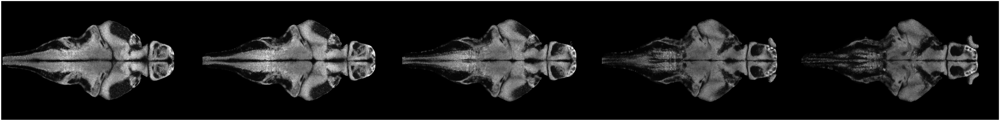

In [5]:
ants.plot(zbb, axis = 2, nslices = 5, slices = np.linspace(150, 190, 5).astype(int), figsize = 10)

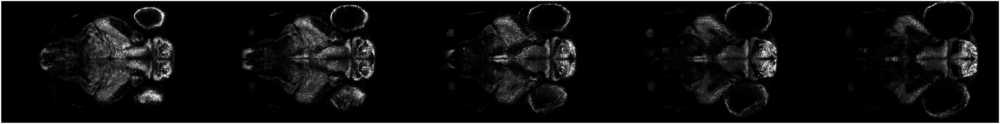

In [6]:
ants.plot(kb, axis = 2, nslices = 5, slices = np.linspace(150, 190, 5).astype(int), figsize = 10)

In [7]:
kb_synra = ants.registration(zbb, kb, type_of_transform = 'SyNRA') 

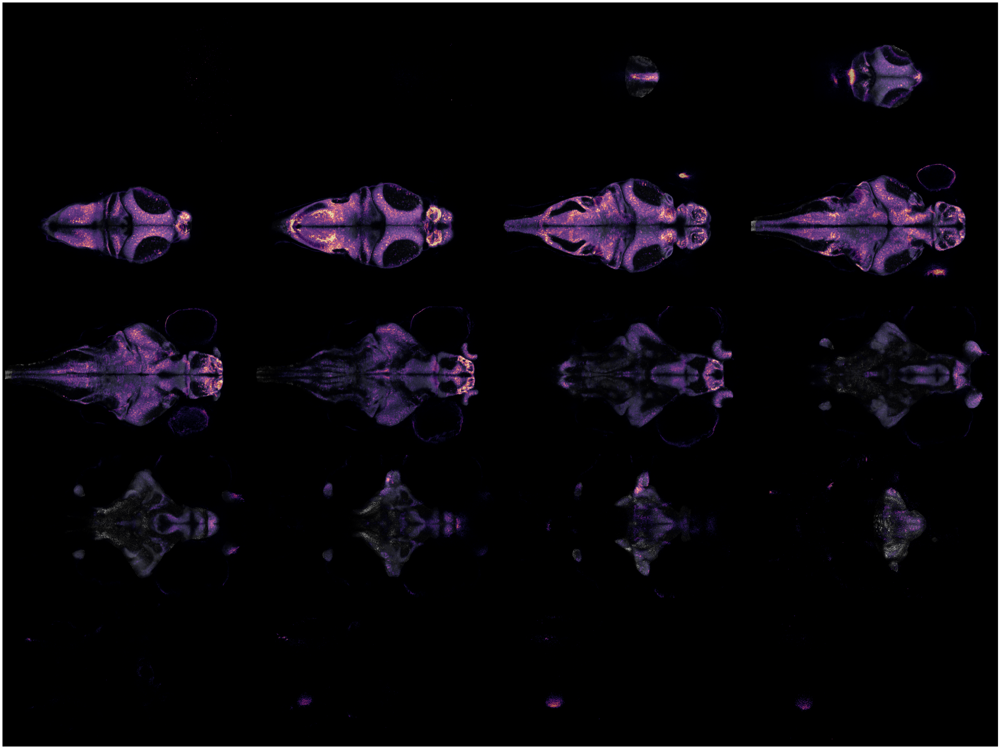

In [8]:
#Inspect registration
rfn.fishplot(zbb,kb_synra['warpedmovout'], orient = 'axial', al = .7)

<Figure size 2000x1000 with 0 Axes>

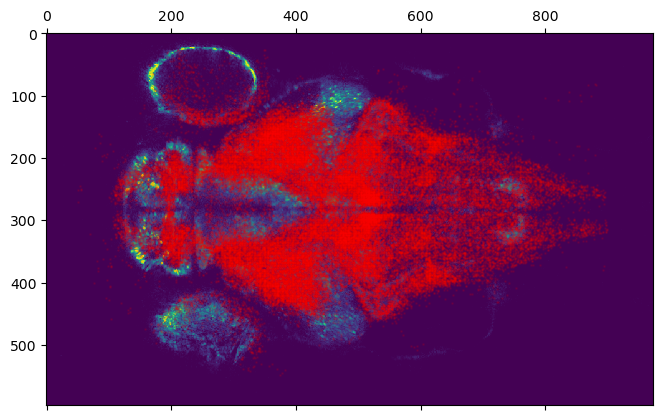

In [223]:
xyz_kb = np.column_stack((np.array(coords['stop_x'])[np.where(coords['stop_y'] < 900 )], np.array(coords['stop_y'])[np.where(coords['stop_y'] < 900 )],np.array(coords['stop_z'])[np.where(coords['stop_y'] < 900 )]))
xyz_kb = xyz_kb.astype(int)
#Check that the registration has worked
#kunst endpoints
#------------------------
plane_num= 200
plt.figure(figsize = (20,10))
plt.matshow(kb[:,:,plane_num])
plt.scatter(xyz_kb[:,1],xyz_kb[:,0], s = 1, c = 'red', alpha = 0.1)
plt.show()

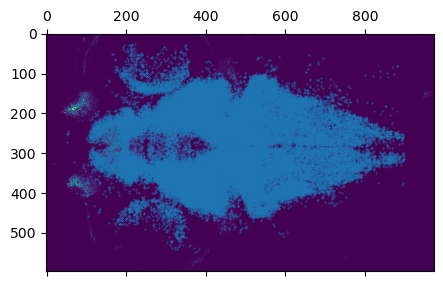

In [231]:
#Create labelled image
#Plot labelled image across all planes - preregistration check

ant_img_kb = kb
lab_img_kb = ant_img_kb*0
mult = xyz_kb[:,0]*xyz_kb[:,1]
zer = np.where(mult <= 0 )
out_x = np.where(xyz_kb[:,0] > 596)
out_y = np.where(xyz_kb[:,1] > 977)
out_z = np.where(xyz_kb[:,2] > 358)

comb = []
comb = np.append(zer, np.append(out_x, np.append(out_y, out_z)))
xyz_kb_n = np.delete(xyz_kb, comb, 0)

#This will create an image of the xy coordinates in the same space as the input ants image. Visualise with plot
count=1
for i in range(xyz_kb_n.shape[0]):
    lab_img_kb[xyz_kb_n[i][0], xyz_kb_n[i][1], xyz_kb_n[i][2]] = int(count)
    count+=1
    
    
plot_kb = np.zeros((lab_img_kb[:,:,0].shape))
for i in range(359):
    plot_kb +=lab_img_kb[:,:,i]
    
    
#Check that the transformation has worked
num = 100
fig,axarr = plt.subplots(figsize = (5,5))
axarr.matshow(ant_img_kb[:,:,num])
axarr.scatter(np.where(plot_kb > 0)[1],np.where(plot_kb > 0)[0], s = 0.1)
plt.show()

In [232]:
#Apply transformation to labelled image
kb_synra_points = ants.apply_transforms(zbb, lab_img_kb, kb_synra['fwdtransforms'], interpolator='nearestNeighbor')
full_plot_kb = np.zeros((kb_synra_points[:,:,0].shape))
for i in range(420):
    full_plot_kb +=kb_synra_points[:,:,i]

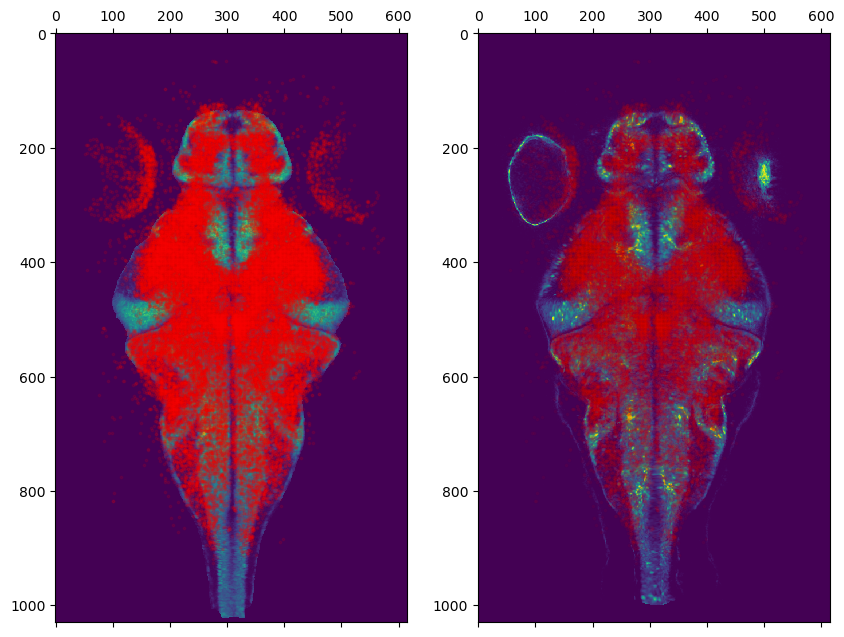

In [233]:
#Check that all neurons are overlaid correctly over brain - postregistration
xnum = 150
fin_plot = full_plot_kb
curr_warped = kb_synra['warpedmovout']
curr_points = kb_synra_points
old_points = xyz_kb_n


fig,axarr = plt.subplots(1,2, figsize = (10,10))
axarr[0].matshow(zbb[:,:,xnum])
axarr[0].scatter(np.where(fin_plot > 0)[1],np.where(fin_plot > 0)[0], s = 3, alpha = 0.1, c = 'red')
axarr[1].matshow(curr_warped[:,:,xnum])
axarr[1].scatter(np.where(fin_plot > 0)[1],np.where(fin_plot > 0)[0], s = 3, alpha = 0.04, c = 'red')
plt.show()


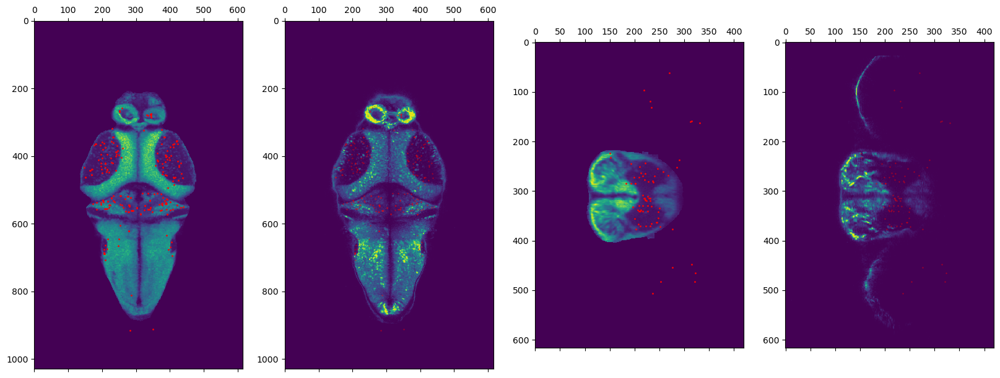

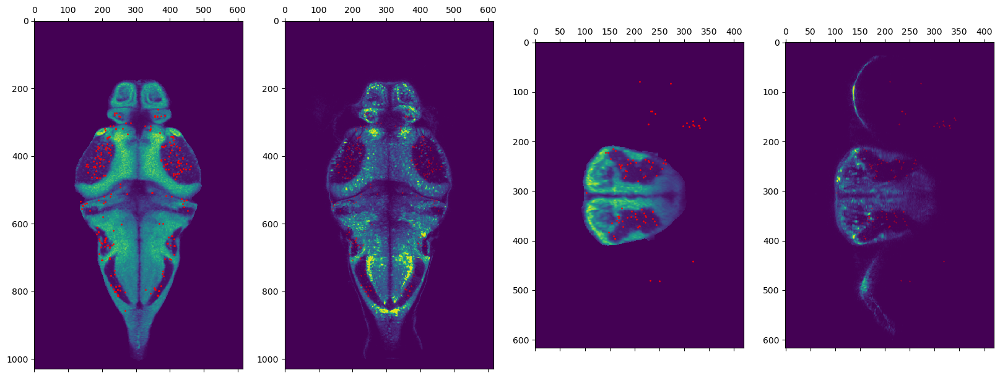

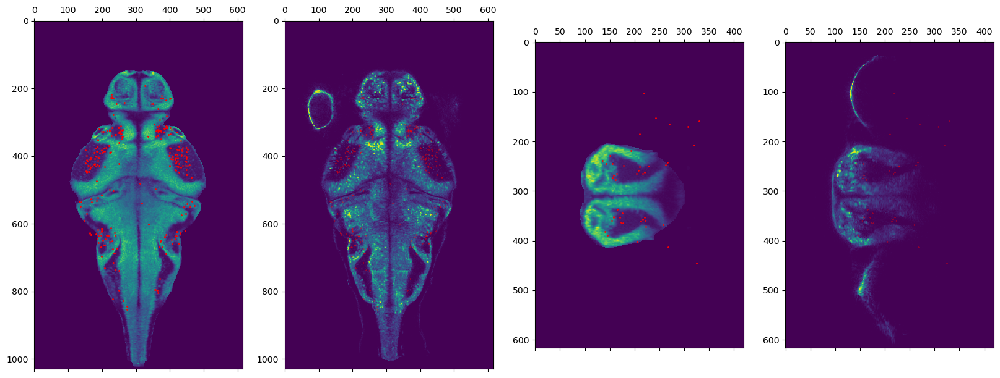

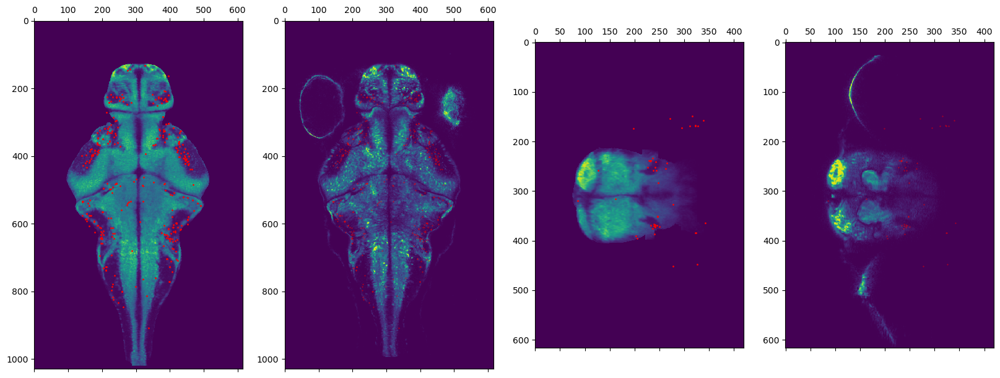

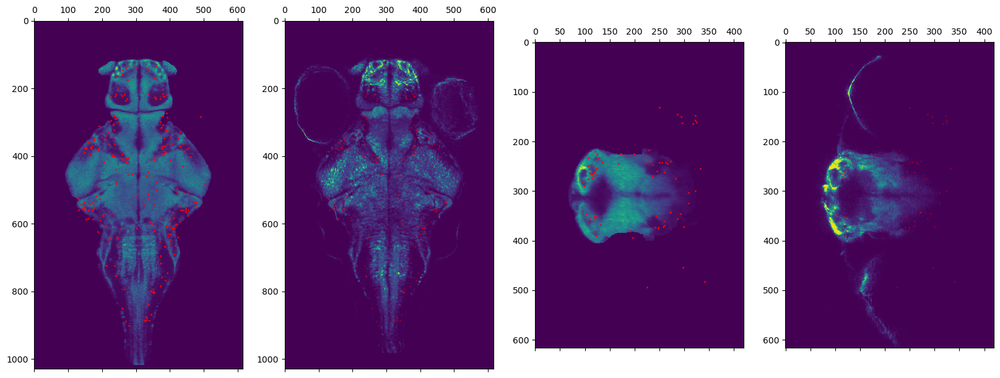

In [234]:
#Check neurons plane by plane
znumlist = np.arange(100, 200, 20)
xnumlist = np.arange(200, 300,20)

for num in range(len(znumlist)):
    fig,axarr = plt.subplots(1,4, figsize = (20,20))
    axarr[0].matshow(zbb[:,:,znumlist[num]])
    axarr[0].scatter(np.where(curr_points[:,:,znumlist[num]] > 0)[1],np.where(curr_points[:,:,znumlist[num]] > 0)[0], s = 1, c = 'red')
    axarr[1].matshow(curr_warped[:,:,znumlist[num]])
    axarr[1].scatter(np.where(curr_points[:,:,znumlist[num]] > 0)[1],np.where(curr_points[:,:,znumlist[num]] > 0)[0], s = 0.1, c = 'red')
    axarr[2].matshow(zbb[xnumlist[num],:,:])
    axarr[2].scatter(np.where(curr_points[xnumlist[num],:,:] > 0)[1],np.where(curr_points[xnumlist[num],:,:] > 0)[0], s = 1, c = 'red')
    axarr[3].matshow(curr_warped[xnumlist[num],:,:])
    axarr[3].scatter(np.where(curr_points[xnumlist[num],:,:] > 0)[1],np.where(curr_points[xnumlist[num],:,:] > 0)[0], s = 0.1, c = 'red')
    plt.show()

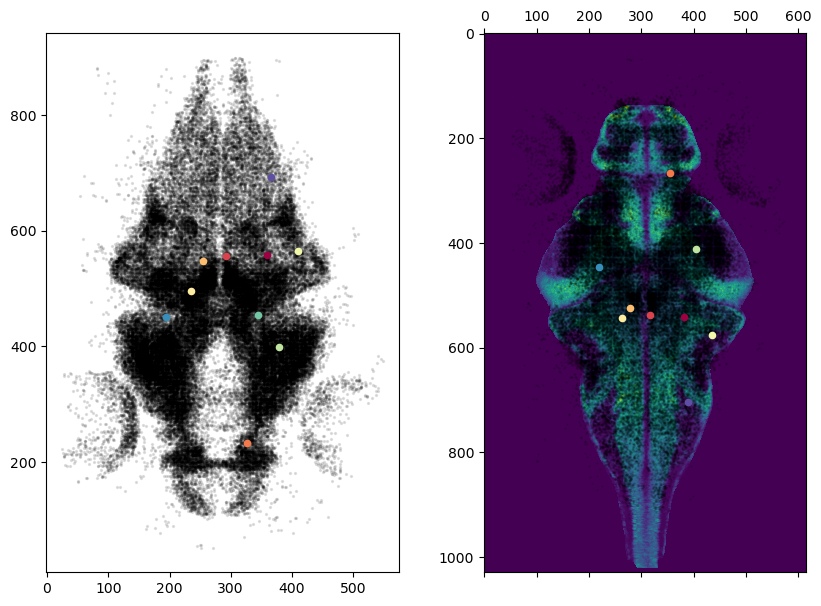

In [237]:
#Check that cell ids are correctly retained
import random
from matplotlib import cm
from matplotlib.axes._axes import _log as matplotlib_axes_logger
matplotlib_axes_logger.setLevel('ERROR')

n_cells = 10
xnum = 150
fig,axarr = plt.subplots(1,2,figsize = (10,7))
axarr[0].scatter(old_points[:,0],old_points[:,1], s = 2, c = 'k', alpha = 0.1)
axarr[1].matshow(zbb[:,:,xnum])
axarr[1].scatter(np.where(fin_plot > 0)[1],np.where(fin_plot > 0)[0], s = 1, alpha = 0.1, c = 'k')

colors  = cm.Spectral(np.linspace(0,1,n_cells))
for i in range(n_cells):
    choose = random.randint(1,len(old_points)+1)
    all_loc = np.where(curr_points[:] == choose)
    mean_loc = np.mean(all_loc[0]), np.mean(all_loc[1])
    axarr[0].scatter(old_points[:,0][choose-1],old_points[:,1][choose-1], s = 20, c = colors[i], alpha = 1)
    axarr[1].scatter(mean_loc[1],mean_loc[0], s = 20, c = colors[i], alpha = 1)
plt.show()

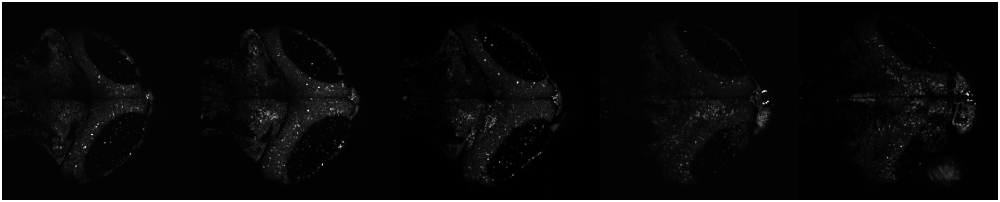

In [20]:
# Define fish name
#----------------------------------------------------------------
experiment = 'PTZ-WILDTYPE'
num = '02'
condition = 'BLN'

#Find fish image
#--------------------------------------------------------
Freg = Ftm + 'Project/' + experiment + '-' + num + '/2photon/sess-01-6dpf/'
os.chdir(Freg)
meanimglist2 = sorted(glob.glob('*' + condition + '*meanimgstack*'))

#Find coordinates
#--------------------------------------------------------
os.chdir(Fdrop + 'Project/' + experiment)
coordlist2 = sorted(glob.glob('*-' + num + '*' + condition + '*realcoord.npy'))

# Visualise fish
#---------------------------------------------------------------------------
f2 = ants.image_read(Freg + os.sep + meanimglist2[0])
f2.set_spacing([.3, .3, 15.])
f2.set_direction(np.array([[-1.,0.,0.],[0.,1.,0.],[0.,0.,1.]])) 
ants.plot(f2, axis = 2, nslices = 5, slices = np.arange(0, 5, 1), figsize = 10)

In [8]:
f2_synra = ants.registration(zbb, f2, type_of_transform = 'SyNRA') 

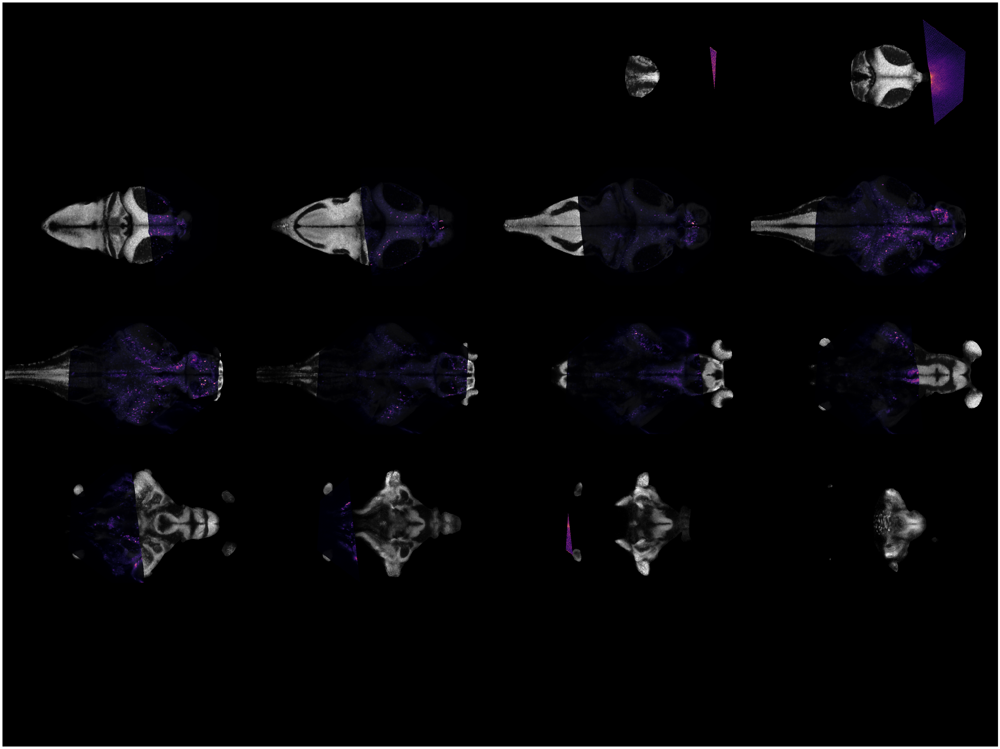

In [17]:
#Inspect registration
rfn.fishplot(zbb,f2_synra['warpedmovout'], orient = 'axial', al = .9)

<Figure size 1000x1000 with 0 Axes>

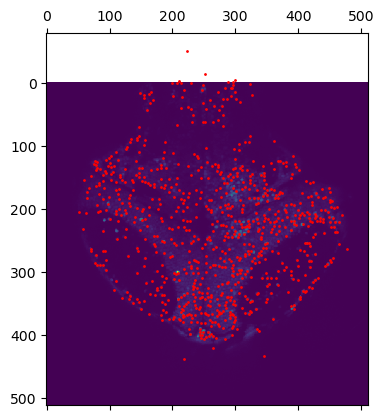

In [98]:
#Rotate coordinates onto image
xyz_2 = np.load(coordlist2[0])
origin = 512/2,512/2
angle = int(meanimglist2[0][meanimglist2[0].find('stack')+6:meanimglist2[0].find('deg')])

dotproduct = np.zeros((xyz_2.shape[0], 2))
for i in range(xyz_2.shape[0]):
    dotproduct[i] = rfn.rotate_point(origin,xyz_2[i,:2], angle)

dp2 = np.column_stack((dotproduct, xyz_2[:,2]))
dp2 = dp2.astype(int)

#------------------------
plane_num= 2
plt.figure(figsize = (10,10))
plt.matshow(f2[:,:,plane_num])
loc = np.where(dp2[:,2] == plane_num)
plt.scatter(dp2[:,0][loc],dp2[:,1][loc], s = 1, c = 'red', alpha = 1)
plt.show()

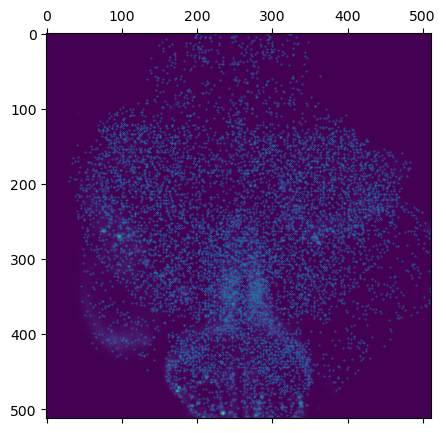

In [148]:
#Create labelled image
#Plot labelled image across all planes - preregistration check

ant_img_2 = f2
lab_img_2 = ant_img_2*0
mult = dp2[:,0]*dp2[:,1]
zer = np.where(mult <= 0 )
out_x = np.where(dp2[:,0] > 511)
out_y = np.where(dp2[:,1] > 511)
comb = []
comb = np.append(zer, np.append(out_x, out_y))
dp2_n = np.delete(dp2, comb, 0)

#This will create an image of the xy coordinates in the same space as the input ants image. Visualise with plot
count=1
for i in range(dp2_n.shape[0]):
    lab_img_2[dp2_n[i][1], dp2_n[i][0], dp2_n[i][2]] = int(count)
    count+=1
    
    
plot_2 = np.zeros((lab_img_2[:,:,0].shape))
for i in range(10):
    plot_2 +=lab_img_2[:,:,i]
    
    
#Check that the transformation has worked
num = 9
fig,axarr = plt.subplots(figsize = (5,5))
axarr.matshow(ant_img_2[:,:,num])
axarr.scatter(np.where(plot_2 > 0)[1],np.where(plot_2 > 0)[0], s = 0.1)
plt.show()

In [149]:
#Apply transformation to labelled image
f2_synra_points = ants.apply_transforms(zbb, lab_img_2, f2_synra['fwdtransforms'], interpolator='nearestNeighbor')
full_plot_2 = np.zeros((f2_synra_points[:,:,0].shape))
for i in range(420):
    full_plot_2 +=f2_synra_points[:,:,i]

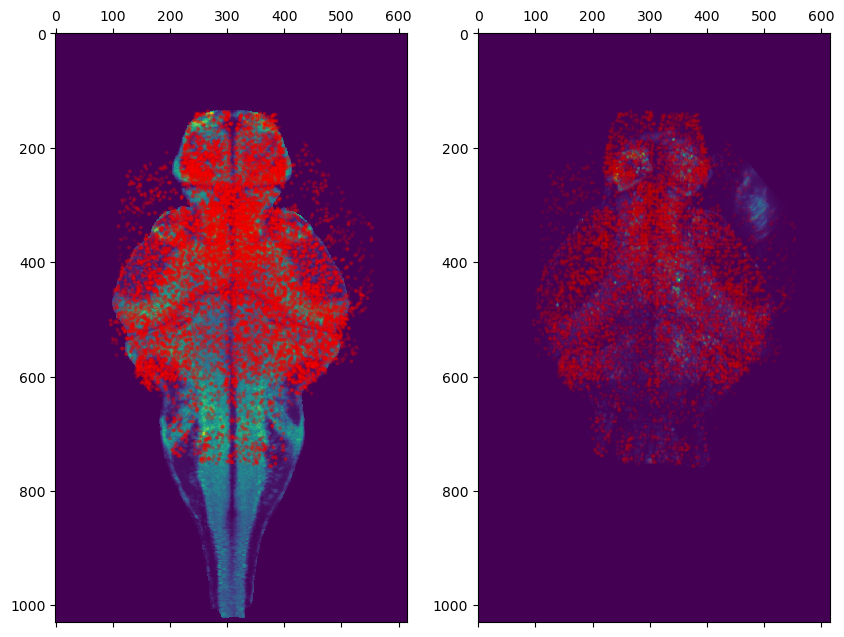

In [153]:
#Check that all neurons are overlaid correctly over brain - postregistration
xnum = 150
fin_plot = full_plot_2
curr_warped = f2_synra['warpedmovout']
curr_points = f2_synra_points
old_points = dp2_n


fig,axarr = plt.subplots(1,2, figsize = (10,10))
axarr[0].matshow(zbb[:,:,xnum])
axarr[0].scatter(np.where(fin_plot > 0)[1],np.where(fin_plot > 0)[0], s = 3, alpha = 0.1, c = 'red')
axarr[1].matshow(curr_warped[:,:,xnum])
axarr[1].scatter(np.where(fin_plot > 0)[1],np.where(fin_plot > 0)[0], s = 3, alpha = 0.04, c = 'red')
plt.show()


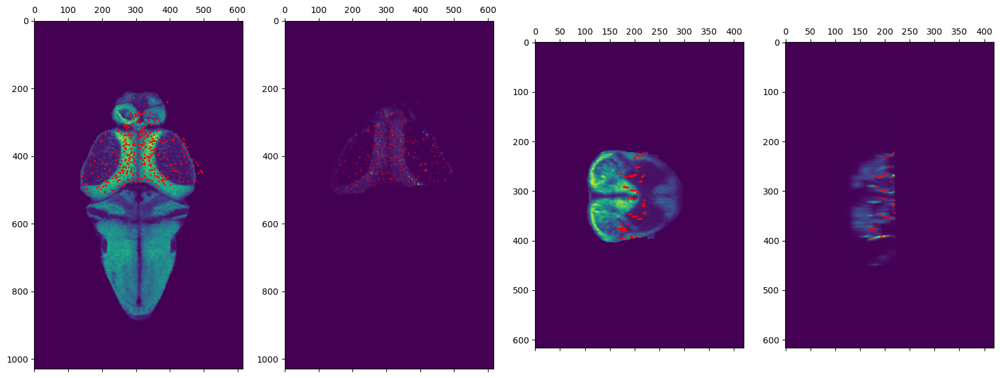

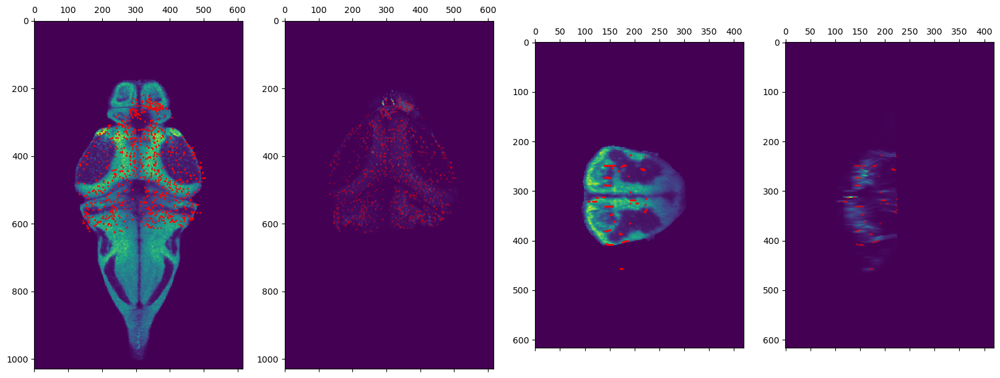

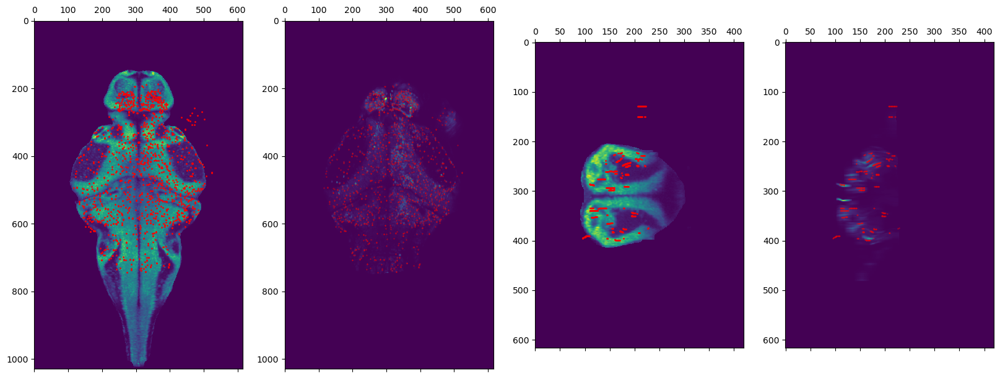

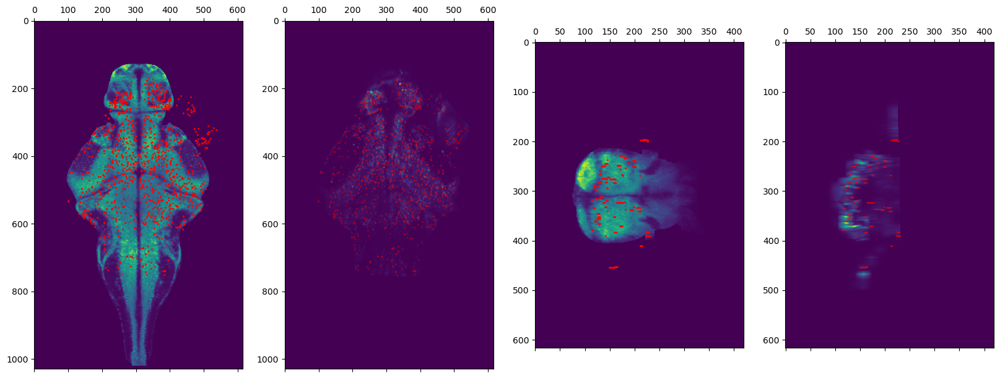

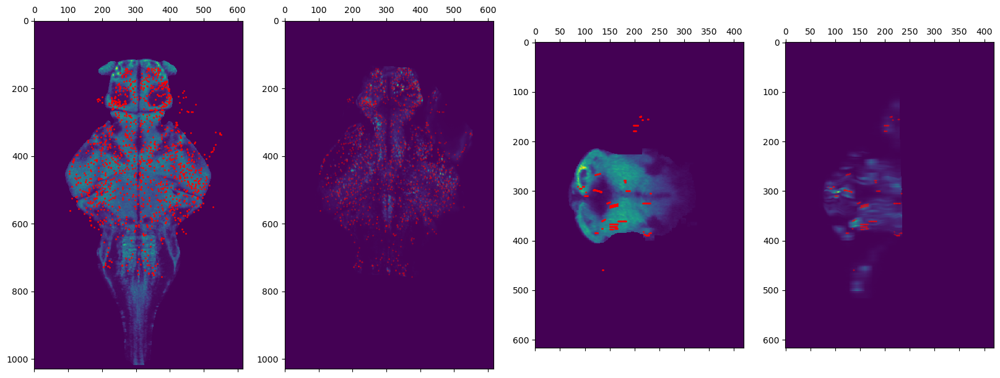

In [154]:
#Check neurons plane by plane
znumlist = np.arange(100, 200, 20)
xnumlist = np.arange(200, 300,20)

for num in range(len(znumlist)):
    fig,axarr = plt.subplots(1,4, figsize = (20,20))
    axarr[0].matshow(zbb[:,:,znumlist[num]])
    axarr[0].scatter(np.where(curr_points[:,:,znumlist[num]] > 0)[1],np.where(curr_points[:,:,znumlist[num]] > 0)[0], s = 1, c = 'red')
    axarr[1].matshow(curr_warped[:,:,znumlist[num]])
    axarr[1].scatter(np.where(curr_points[:,:,znumlist[num]] > 0)[1],np.where(curr_points[:,:,znumlist[num]] > 0)[0], s = 0.1, c = 'red')
    axarr[2].matshow(zbb[xnumlist[num],:,:])
    axarr[2].scatter(np.where(curr_points[xnumlist[num],:,:] > 0)[1],np.where(curr_points[xnumlist[num],:,:] > 0)[0], s = 1, c = 'red')
    axarr[3].matshow(curr_warped[xnumlist[num],:,:])
    axarr[3].scatter(np.where(curr_points[xnumlist[num],:,:] > 0)[1],np.where(curr_points[xnumlist[num],:,:] > 0)[0], s = 0.1, c = 'red')
    plt.show()

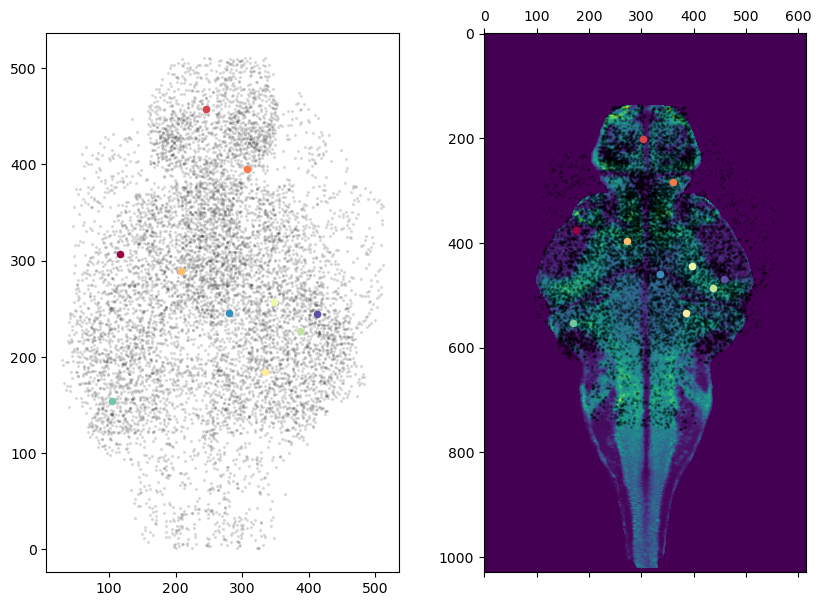

In [189]:
#Check that cell ids are correctly retained
import random
from matplotlib import cm
from matplotlib.axes._axes import _log as matplotlib_axes_logger
matplotlib_axes_logger.setLevel('ERROR')

n_cells = 10
xnum = 150
fig,axarr = plt.subplots(1,2,figsize = (10,7))
axarr[0].scatter(old_points[:,0],old_points[:,1], s = 2, c = 'k', alpha = 0.1)
axarr[1].matshow(zbb[:,:,xnum])
axarr[1].scatter(np.where(fin_plot > 0)[1],np.where(fin_plot > 0)[0], s = 1, alpha = 0.1, c = 'k')

colors  = cm.Spectral(np.linspace(0,1,n_cells))
for i in range(n_cells):
    choose = random.randint(1,len(old_points)+1)
    all_loc = np.where(curr_points[:] == choose)
    mean_loc = np.mean(all_loc[0]), np.mean(all_loc[1])
    axarr[0].scatter(old_points[:,0][choose-1],old_points[:,1][choose-1], s = 20, c = colors[i], alpha = 1)
    axarr[1].scatter(mean_loc[1],mean_loc[0], s = 20, c = colors[i], alpha = 1)
plt.show()

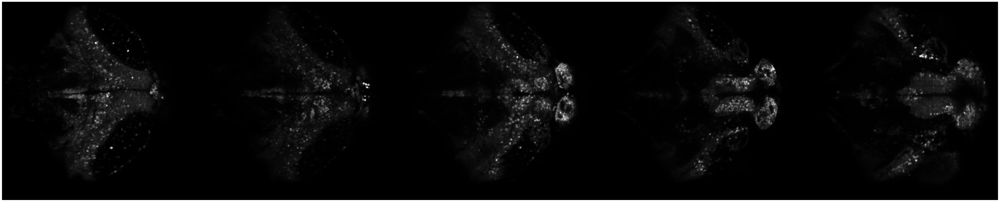

In [22]:
# Define fish name
#----------------------------------------------------------------
experiment = 'PTZ-WILDTYPE'
num = '06'
condition = 'BLN'

#Find fish image
#--------------------------------------------------------
Freg = Ftm + 'Project/' + experiment + '-' + num + '/2photon/sess-01-6dpf/'
os.chdir(Freg)
meanimglist6 = sorted(glob.glob('*' + condition + '*meanimgstack*'))

#Find coordinates
#--------------------------------------------------------
os.chdir(Fdrop + 'Project/' + experiment)
coordlist6 = sorted(glob.glob('*-' + num + '*' + condition + '*realcoord.npy'))

# Visualise fish
#---------------------------------------------------------------------------
f6 = ants.image_read(Freg + os.sep + meanimglist6[0])
f6.set_spacing([.3, .3, 15.])
f6.set_direction(np.array([[-1.,0.,0.],[0.,1.,0.],[0.,0.,1.]])) 
ants.plot(f6, axis = 2, nslices = 5, slices = np.arange(0, 5, 1), figsize = 10)

In [10]:
f6_synra = ants.registration(zbb, f6, type_of_transform = 'SyNRA') 

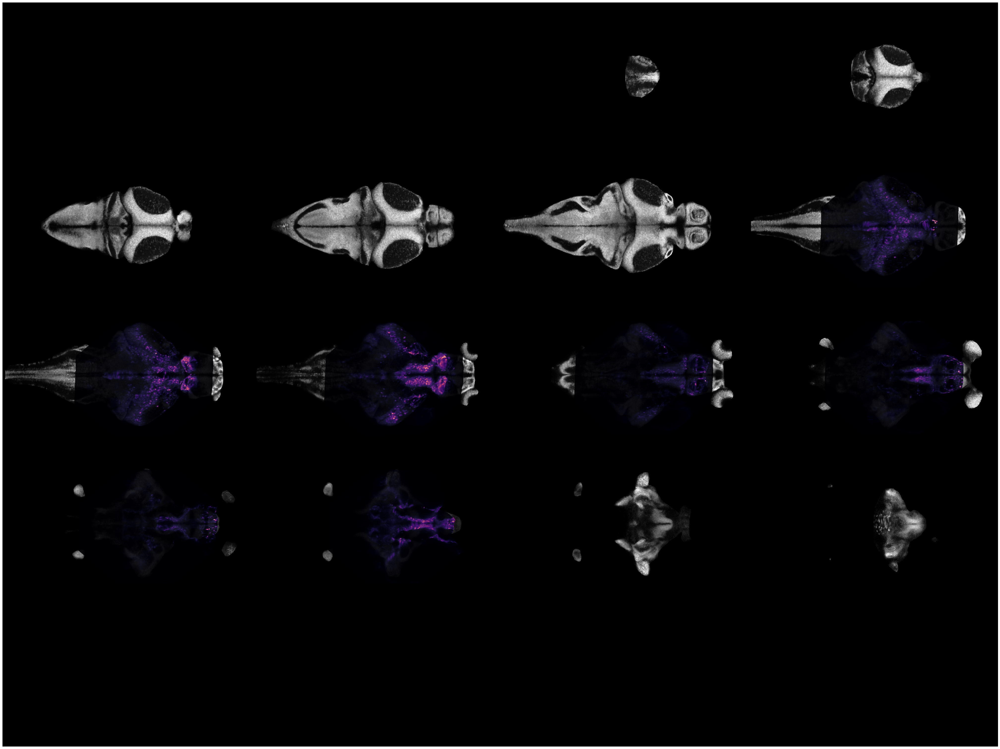

In [18]:
#Inspect registration
rfn.fishplot(zbb,f6_synra['warpedmovout'], orient = 'axial', al = .9)

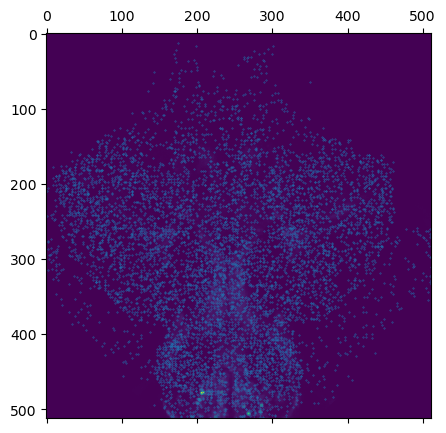

In [195]:
#Create labelled image
#Plot labelled image across all planes - preregistration check

ant_img_6 = f6
lab_img_6 = ant_img_6*0
mult = dp6[:,0]*dp6[:,1]
zer = np.where(mult <= 0 )
out_x = np.where(dp6[:,0] > 511)
out_y = np.where(dp6[:,1] > 511)
comb = []
comb = np.append(zer, np.append(out_x, out_y))
dp6_n = np.delete(dp6, comb, 0)

#This will create an image of the xy coordinates in the same space as the input ants image. Visualise with plot
count=1
for i in range(dp6_n.shape[0]):
    lab_img_6[dp6_n[i][1], dp6_n[i][0], dp6_n[i][2]] = int(count)
    count+=1
    
    
plot_6 = np.zeros((lab_img_6[:,:,0].shape))
for i in range(10):
    plot_6 +=lab_img_6[:,:,i]
    
    
#Check that the transformation has worked
num = 9
fig,axarr = plt.subplots(figsize = (5,5))
axarr.matshow(ant_img_6[:,:,num])
axarr.scatter(np.where(plot_6 > 0)[1],np.where(plot_6 > 0)[0], s = 0.1)
plt.show()

In [196]:
#Apply transformation to labelled image
f6_synra_points = ants.apply_transforms(zbb, lab_img_6, f6_synra['fwdtransforms'], interpolator='nearestNeighbor')
full_plot_6 = np.zeros((f6_synra_points[:,:,0].shape))
for i in range(420):
    full_plot_6 +=f6_synra_points[:,:,i]

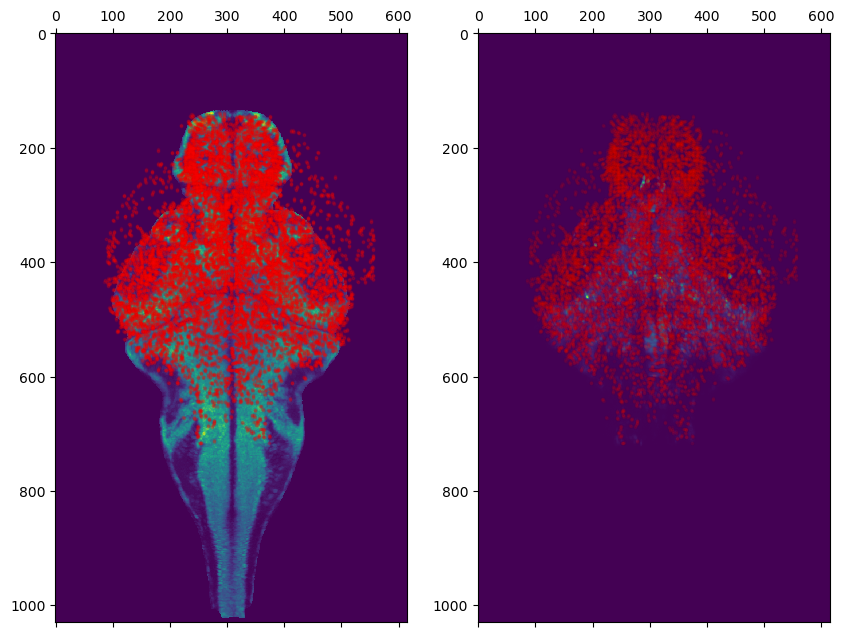

In [197]:
#Check that all neurons are overlaid correctly over brain - postregistration
xnum = 150
fin_plot = full_plot_6
curr_warped = f6_synra['warpedmovout']
curr_points = f6_synra_points
old_points = dp6_n


fig,axarr = plt.subplots(1,2, figsize = (10,10))
axarr[0].matshow(zbb[:,:,xnum])
axarr[0].scatter(np.where(fin_plot > 0)[1],np.where(fin_plot > 0)[0], s = 3, alpha = 0.1, c = 'red')
axarr[1].matshow(curr_warped[:,:,xnum])
axarr[1].scatter(np.where(fin_plot > 0)[1],np.where(fin_plot > 0)[0], s = 3, alpha = 0.04, c = 'red')
plt.show()


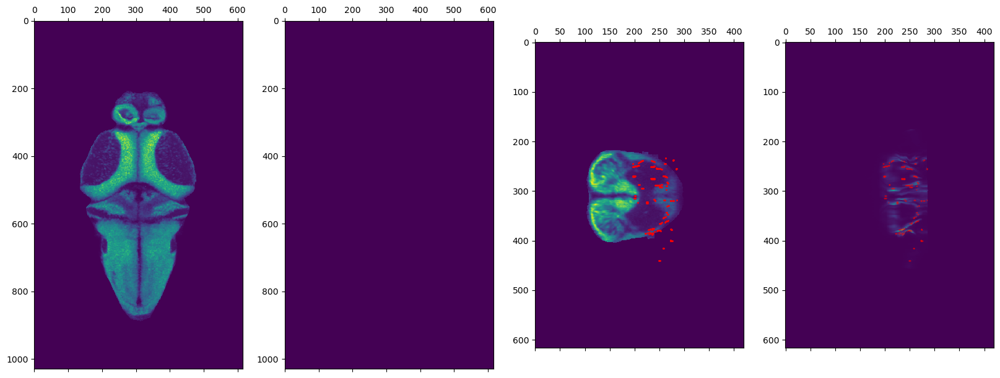

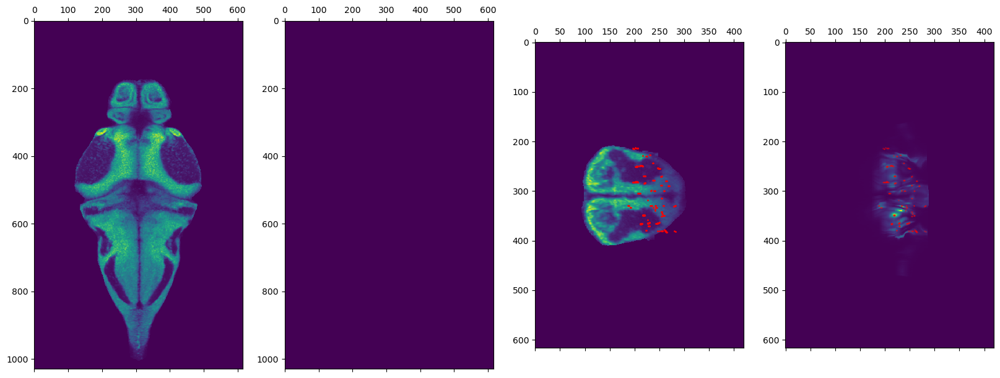

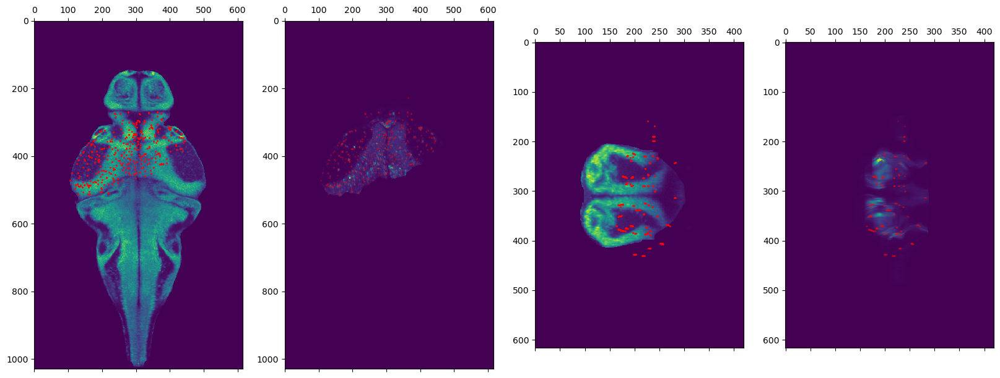

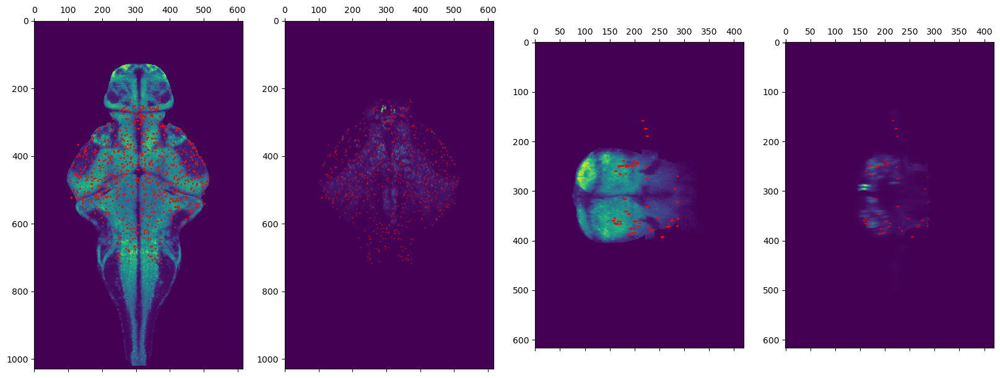

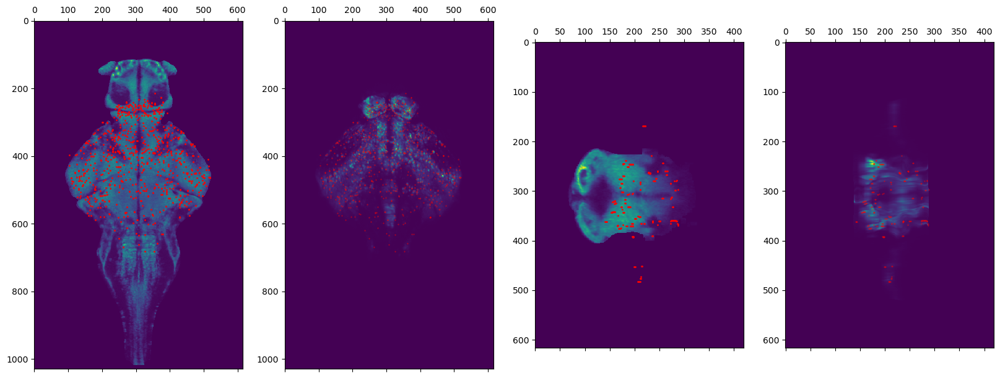

In [198]:
#Check neurons plane by plane
znumlist = np.arange(100, 200, 20)
xnumlist = np.arange(200, 300,20)

for num in range(len(znumlist)):
    fig,axarr = plt.subplots(1,4, figsize = (20,20))
    axarr[0].matshow(zbb[:,:,znumlist[num]])
    axarr[0].scatter(np.where(curr_points[:,:,znumlist[num]] > 0)[1],np.where(curr_points[:,:,znumlist[num]] > 0)[0], s = 1, c = 'red')
    axarr[1].matshow(curr_warped[:,:,znumlist[num]])
    axarr[1].scatter(np.where(curr_points[:,:,znumlist[num]] > 0)[1],np.where(curr_points[:,:,znumlist[num]] > 0)[0], s = 0.1, c = 'red')
    axarr[2].matshow(zbb[xnumlist[num],:,:])
    axarr[2].scatter(np.where(curr_points[xnumlist[num],:,:] > 0)[1],np.where(curr_points[xnumlist[num],:,:] > 0)[0], s = 1, c = 'red')
    axarr[3].matshow(curr_warped[xnumlist[num],:,:])
    axarr[3].scatter(np.where(curr_points[xnumlist[num],:,:] > 0)[1],np.where(curr_points[xnumlist[num],:,:] > 0)[0], s = 0.1, c = 'red')
    plt.show()

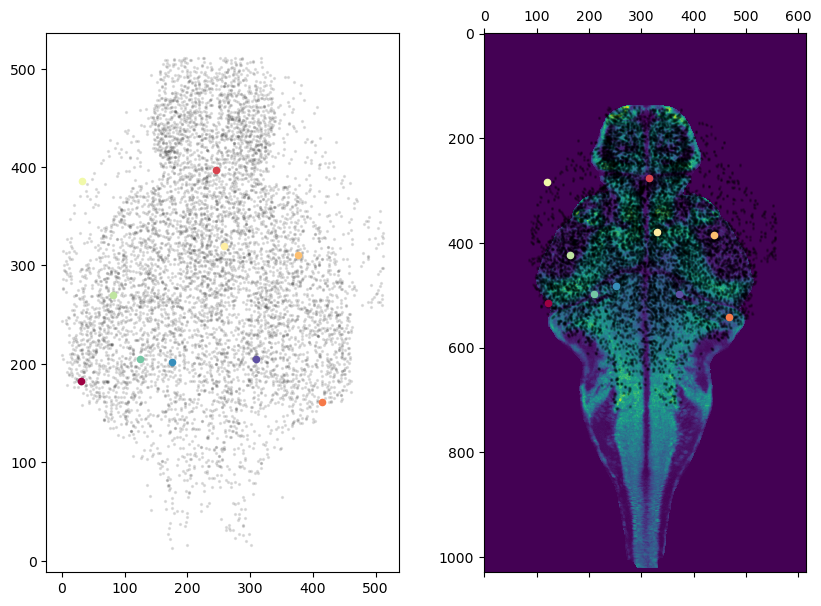

In [199]:
#Check that cell ids are correctly retained
import random
from matplotlib import cm
from matplotlib.axes._axes import _log as matplotlib_axes_logger
matplotlib_axes_logger.setLevel('ERROR')

n_cells = 10
xnum = 150
fig,axarr = plt.subplots(1,2,figsize = (10,7))
axarr[0].scatter(old_points[:,0],old_points[:,1], s = 2, c = 'k', alpha = 0.1)
axarr[1].matshow(zbb[:,:,xnum])
axarr[1].scatter(np.where(fin_plot > 0)[1],np.where(fin_plot > 0)[0], s = 1, alpha = 0.1, c = 'k')

colors  = cm.Spectral(np.linspace(0,1,n_cells))
for i in range(n_cells):
    choose = random.randint(1,len(old_points)+1)
    all_loc = np.where(curr_points[:] == choose)
    mean_loc = np.mean(all_loc[0]), np.mean(all_loc[1])
    axarr[0].scatter(old_points[:,0][choose-1],old_points[:,1][choose-1], s = 20, c = colors[i], alpha = 1)
    axarr[1].scatter(mean_loc[1],mean_loc[0], s = 20, c = colors[i], alpha = 1)
plt.show()

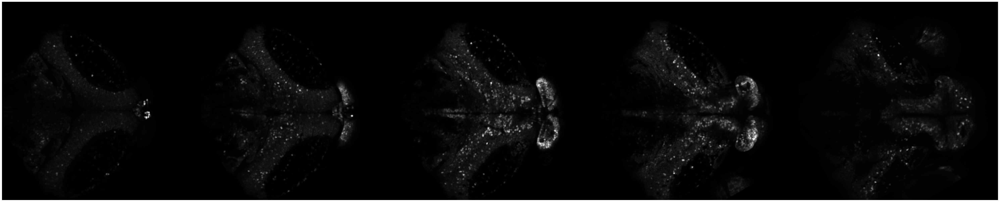

In [21]:
# Define fish name
#----------------------------------------------------------------
experiment = 'PTZ-WILDTYPE'
num = '12'
condition = 'BLN'

#Find fish image
#--------------------------------------------------------
Freg = Ftm + 'Project/' + experiment + '-' + num + '/2photon/sess-01-6dpf/'
os.chdir(Freg)
meanimglist12 = sorted(glob.glob('*' + condition + '*meanimgstack*'))

#Find coordinates
#--------------------------------------------------------
os.chdir(Fdrop + 'Project/' + experiment)
coordlist12 = sorted(glob.glob('*-' + num + '*' + condition + '*realcoord.npy'))

# Visualise fish
#---------------------------------------------------------------------------
f12 = ants.image_read(Freg + os.sep + meanimglist12[0])
f12.set_spacing([.3, .3, 15.])
f12.set_direction(np.array([[-1.,0.,0.],[0.,1.,0.],[0.,0.,1.]])) 
ants.plot(f12, axis = 2, nslices = 5, slices = np.arange(0, 5, 1), figsize = 10)

In [12]:
f12_synra = ants.registration(zbb, f12, type_of_transform = 'SyNRA') 

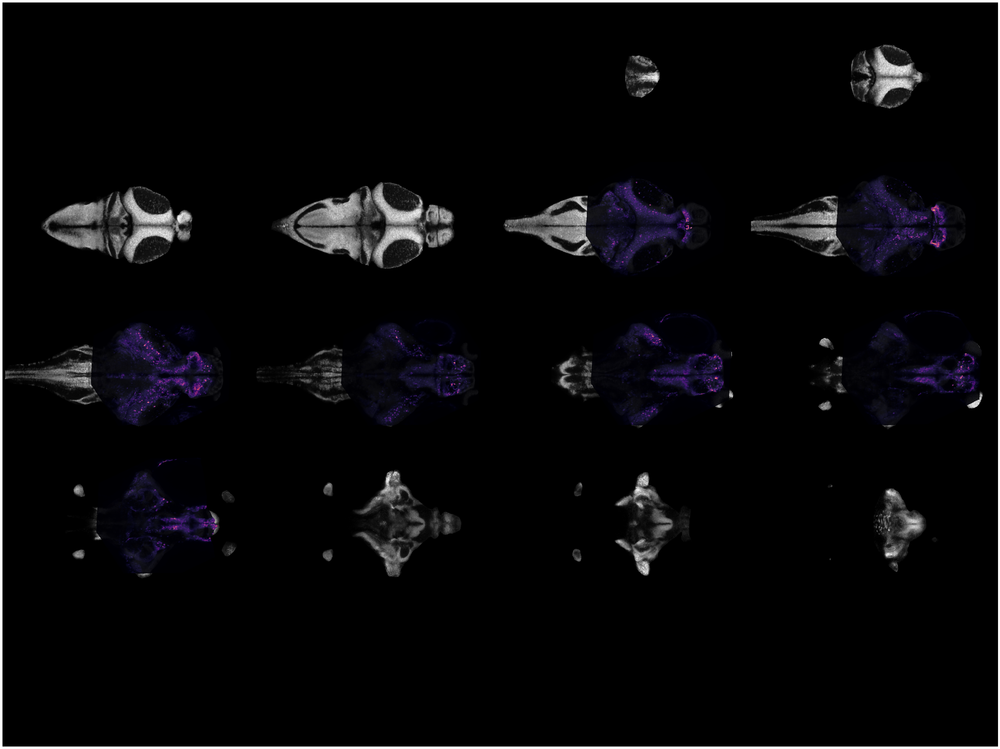

In [19]:
#Inspect registration
rfn.fishplot(zbb,f12_synra['warpedmovout'], orient = 'axial', al = .9)

<Figure size 1000x1000 with 0 Axes>

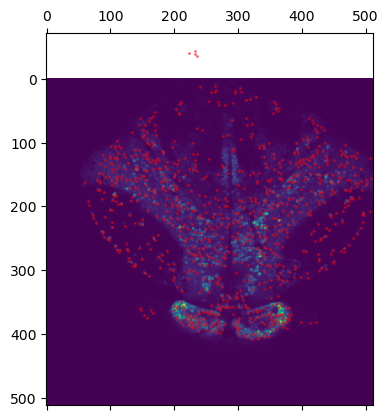

In [200]:
xyz_12 = np.load(coordlist12[0])
origin = 512/2,512/2
angle = int(meanimglist12[0][meanimglist12[0].find('stack')+6:meanimglist12[0].find('deg')])

dotproduct = np.zeros((xyz_12.shape[0], 2))
for i in range(xyz_12.shape[0]):
    dotproduct[i] = rfn.rotate_point(origin,xyz_12[i,:2], angle)

dp12 = np.column_stack((dotproduct, xyz_12[:,2]))
dp12 = dp12.astype(int)

#Check that the registration has worked
#kunst endpoints
#------------------------
plane_num= 2
plt.figure(figsize = (10,10))
plt.matshow(f12[:,:,plane_num])
loc = np.where(dp12[:,2] == plane_num)
#plt.scatter(xyz_5[:,0],xyz_5[:,1], s = 1, c = 'red', alpha = 0.1)
plt.scatter(dp12[:,0][loc],dp12[:,1][loc], s = 1, c = 'red', alpha = 0.5)
plt.show()

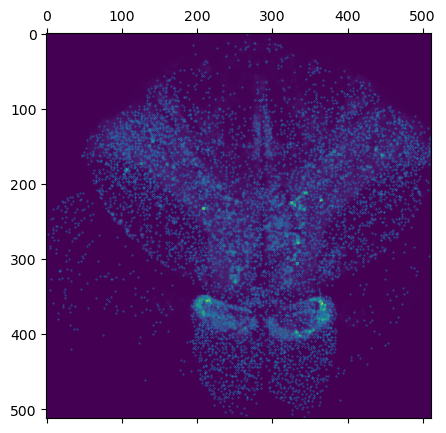

In [202]:
#Create labelled image
#Plot labelled image across all planes - preregistration check

ant_img_12 = f12
lab_img_12 = ant_img_12*0
mult = dp12[:,0]*dp12[:,1]
zer = np.where(mult <= 0 )
out_x = np.where(dp12[:,0] > 511)
out_y = np.where(dp12[:,1] > 511)
comb = []
comb = np.append(zer, np.append(out_x, out_y))
dp12_n = np.delete(dp12, comb, 0)

#This will create an image of the xy coordinates in the same space as the input ants image. Visualise with plot
count=1
for i in range(dp12_n.shape[0]):
    lab_img_12[dp12_n[i][1], dp12_n[i][0], dp12_n[i][2]] = int(count)
    count+=1
    
    
plot_12 = np.zeros((lab_img_12[:,:,0].shape))
for i in range(10):
    plot_12 +=lab_img_12[:,:,i]
    
    
#Check that the transformation has worked
num = 2
fig,axarr = plt.subplots(figsize = (5,5))
axarr.matshow(ant_img_12[:,:,num])
axarr.scatter(np.where(plot_12 > 0)[1],np.where(plot_12 > 0)[0], s = 0.1)
plt.show()

In [203]:
#Apply transformation to labelled image
f12_synra_points = ants.apply_transforms(zbb, lab_img_12, f12_synra['fwdtransforms'], interpolator='nearestNeighbor')
full_plot_12 = np.zeros((f12_synra_points[:,:,0].shape))
for i in range(420):
    full_plot_12 +=f12_synra_points[:,:,i]

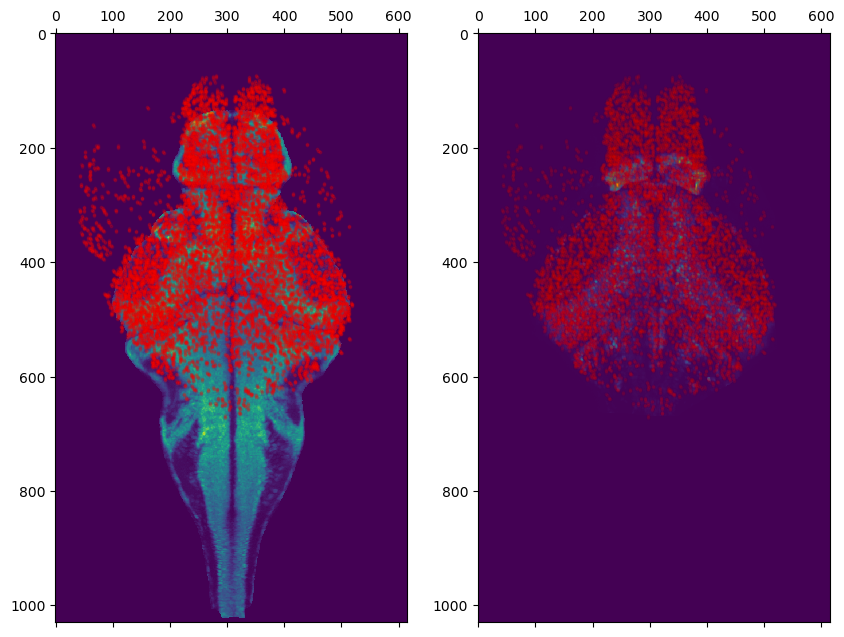

In [207]:
#Check that all neurons are overlaid correctly over brain - postregistration
xnum = 150
fin_plot = full_plot_12
curr_warped = f12_synra['warpedmovout']
curr_points = f12_synra_points
old_points = dp12_n


fig,axarr = plt.subplots(1,2, figsize = (10,10))
axarr[0].matshow(zbb[:,:,xnum])
axarr[0].scatter(np.where(fin_plot > 0)[1],np.where(fin_plot > 0)[0], s = 3, alpha = 0.1, c = 'red')
axarr[1].matshow(curr_warped[:,:,xnum])
axarr[1].scatter(np.where(fin_plot > 0)[1],np.where(fin_plot > 0)[0], s = 3, alpha = 0.04, c = 'red')
plt.show()


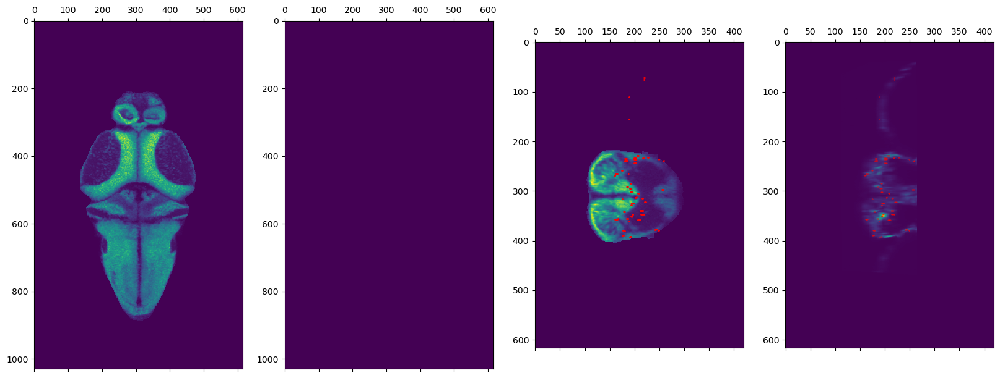

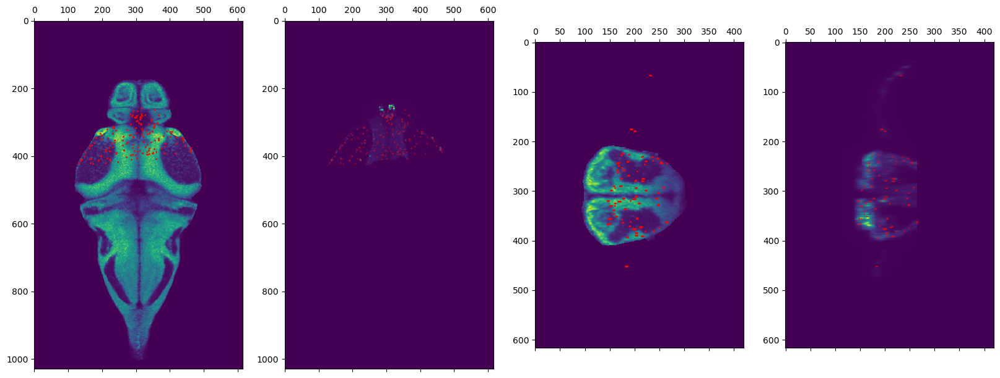

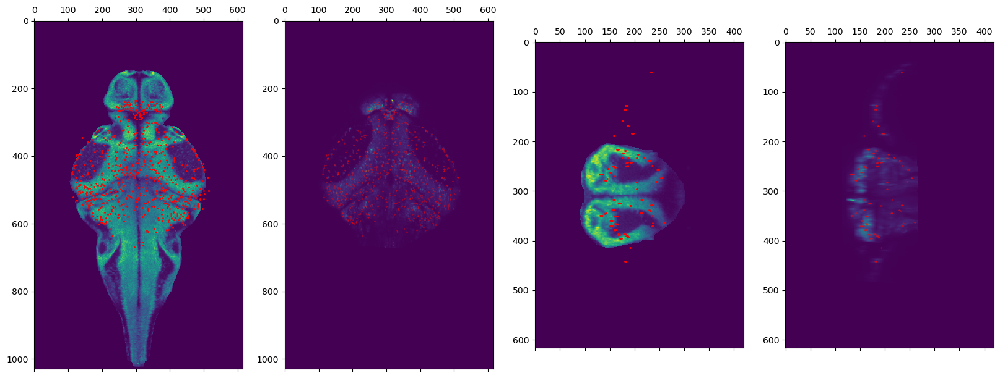

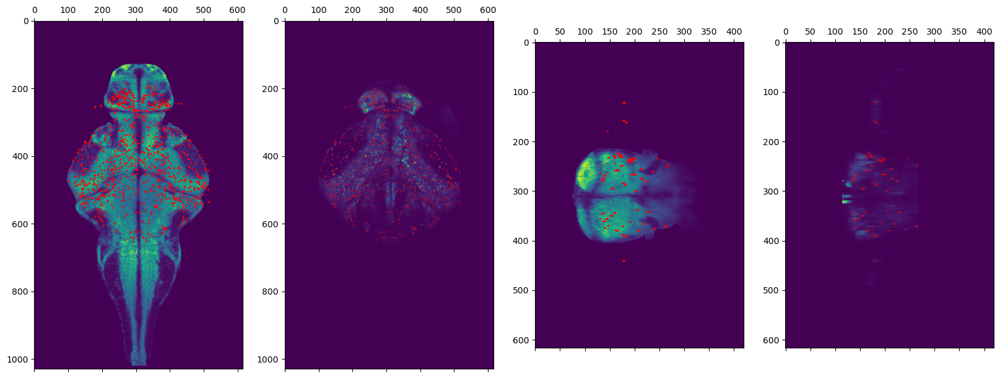

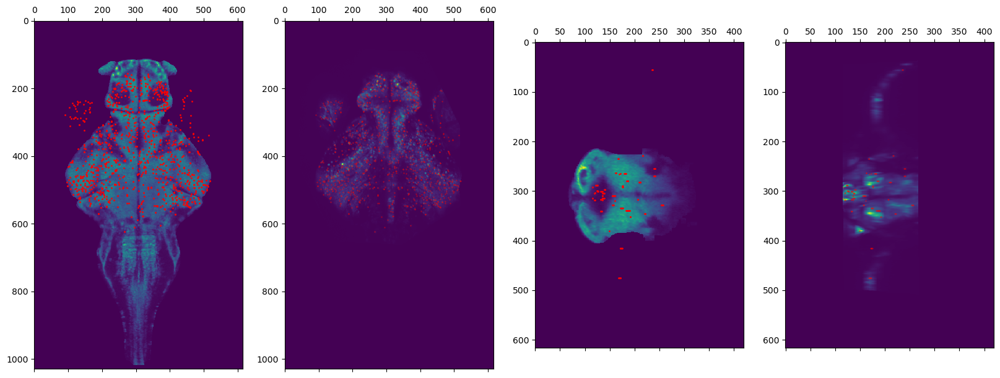

In [208]:
#Check neurons plane by plane
znumlist = np.arange(100, 200, 20)
xnumlist = np.arange(200, 300,20)

for num in range(len(znumlist)):
    fig,axarr = plt.subplots(1,4, figsize = (20,20))
    axarr[0].matshow(zbb[:,:,znumlist[num]])
    axarr[0].scatter(np.where(curr_points[:,:,znumlist[num]] > 0)[1],np.where(curr_points[:,:,znumlist[num]] > 0)[0], s = 1, c = 'red')
    axarr[1].matshow(curr_warped[:,:,znumlist[num]])
    axarr[1].scatter(np.where(curr_points[:,:,znumlist[num]] > 0)[1],np.where(curr_points[:,:,znumlist[num]] > 0)[0], s = 0.1, c = 'red')
    axarr[2].matshow(zbb[xnumlist[num],:,:])
    axarr[2].scatter(np.where(curr_points[xnumlist[num],:,:] > 0)[1],np.where(curr_points[xnumlist[num],:,:] > 0)[0], s = 1, c = 'red')
    axarr[3].matshow(curr_warped[xnumlist[num],:,:])
    axarr[3].scatter(np.where(curr_points[xnumlist[num],:,:] > 0)[1],np.where(curr_points[xnumlist[num],:,:] > 0)[0], s = 0.1, c = 'red')
    plt.show()

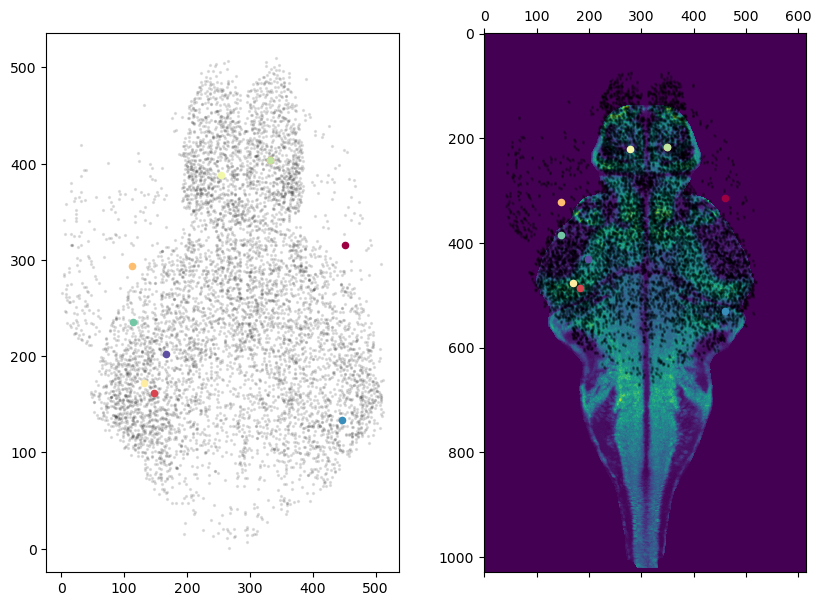

In [209]:
#Check that cell ids are correctly retained
import random
from matplotlib import cm
from matplotlib.axes._axes import _log as matplotlib_axes_logger
matplotlib_axes_logger.setLevel('ERROR')

n_cells = 10
xnum = 150
fig,axarr = plt.subplots(1,2,figsize = (10,7))
axarr[0].scatter(old_points[:,0],old_points[:,1], s = 2, c = 'k', alpha = 0.1)
axarr[1].matshow(zbb[:,:,xnum])
axarr[1].scatter(np.where(fin_plot > 0)[1],np.where(fin_plot > 0)[0], s = 1, alpha = 0.1, c = 'k')

colors  = cm.Spectral(np.linspace(0,1,n_cells))
for i in range(n_cells):
    choose = random.randint(1,len(old_points)+1)
    all_loc = np.where(curr_points[:] == choose)
    mean_loc = np.mean(all_loc[0]), np.mean(all_loc[1])
    axarr[0].scatter(old_points[:,0][choose-1],old_points[:,1][choose-1], s = 20, c = colors[i], alpha = 1)
    axarr[1].scatter(mean_loc[1],mean_loc[0], s = 20, c = colors[i], alpha = 1)
plt.show()

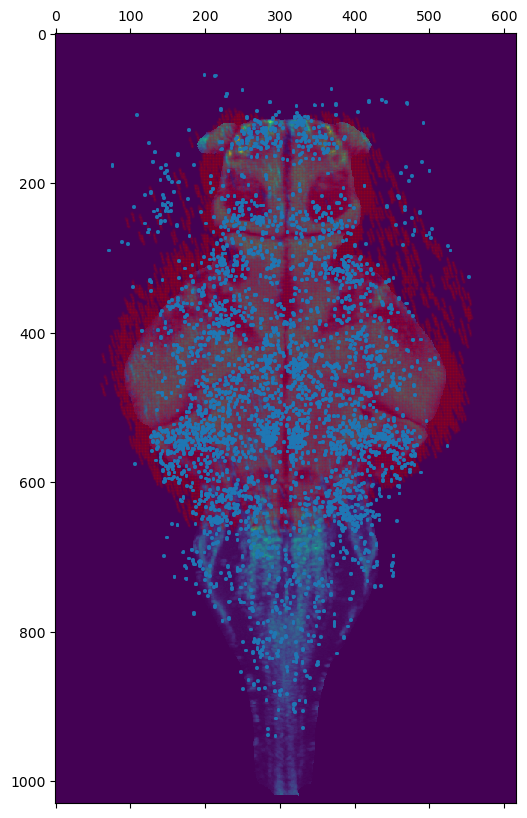

In [189]:
#Check that the transformation has worked
num = 180
fig,axarr = plt.subplots(figsize = (10,10))
axarr.matshow(zbb[:,:,num])
axarr.scatter(np.where(fin_plot_5 > 0)[1],np.where(fin_plot_5 > 0)[0], s = 1, alpha = 0.03, c = 'red')
axarr.scatter(np.where(fin_plot > 0)[1],np.where(fin_plot > 0)[0], s = 1)
plt.show()

# Build structural connectivity matrix
* ID = cell number
* start = cell soma
* end = end of axonal/dendritic process
* structural conn = undirected - find start and end coordinates - count number of connections from one parcel to another

In [133]:
import pandas as pd
coords = pd.read_csv(conn_list[0])
coords

,ID,start_x,start_y,start_z,stop_x,stop_y,stop_z
0,1,419.605743,372.904877,208.815018,405.110321,352.853363,197.227615
1,1,419.605743,372.904877,208.815018,401.367859,341.110229,212.254959
2,1,419.605743,372.904877,208.815018,401.930298,335.409088,213.875122
3,1,419.605743,372.904877,208.815018,411.859863,343.718719,214.643921
4,1,419.605743,372.904877,208.815018,419.022858,348.411011,217.191559
...,...,...,...,...,...,...,...
81277,3119,260.879578,234.483383,106.049133,229.904556,214.334442,110.568687
81278,3119,260.879578,234.483383,106.049133,238.541321,210.633423,82.402649
81279,3119,260.879578,234.483383,106.049133,243.640427,223.822769,98.493629
81280,3119,260.879578,234.483383,106.049133,217.230270,240.188019,95.431923


In [224]:
total_conn = len(coords)
total_conn

81282

In [269]:
prac = {'ID': coords['ID'], 'start_x':(coords['start_x']).astype(int), 'start_y':(coords['start_y']).astype(int)
               , 'start_z':(coords['start_z']/5).astype(int), 'stop_x':(coords['stop_x']).astype(int), 
               'stop_y':(coords['stop_y']).astype(int), 'stop_z': (coords['stop_z']/3).astype(int)}
coords_prac = pd.DataFrame(prac)
coords_prac

,ID,start_x,start_y,start_z,stop_x,stop_y,stop_z
0,1,419,372,41,405,352,65
1,1,419,372,41,401,341,70
2,1,419,372,41,401,335,71
3,1,419,372,41,411,343,71
4,1,419,372,41,419,348,72
...,...,...,...,...,...,...,...
81277,3119,260,234,21,229,214,36
81278,3119,260,234,21,238,210,27
81279,3119,260,234,21,243,223,32
81280,3119,260,234,21,217,240,31


In [270]:
from itertools import groupby

for i in range(np.max(coords_prac['ID'])):
    curr_mat = coords_prac[coords_prac['ID'] == i+1]
    if len(set(curr_mat['start_x'])) > 1:
        print('False')
    if len(set(curr_mat['start_y'])) > 1:
        print('False')
    if len(set(curr_mat['start_z'])) > 1:
        print('False')

In [291]:
#1000 x 1000 matrix
adj_mat = np.zeros((1000,1000))

for i in range(np.max(coords_prac['ID'])):
    curr_cell = coords_prac[coords_prac['ID'] == i+1]
    start_coords = np.min(curr_cell['start_x']), np.min(curr_cell['start_y']), np.min(curr_cell['start_z'])
    start_k = k_lab[start_coords]
    stop_mat = np.vstack((curr_cell['stop_x'],curr_cell['stop_y'], curr_cell['stop_z'])).T
    for x in range(len(stop_mat)):
        stop_k = k_lab[tuple(stop_mat[x])]
        adj_mat[start_k - 1, stop_k - 1] = 1


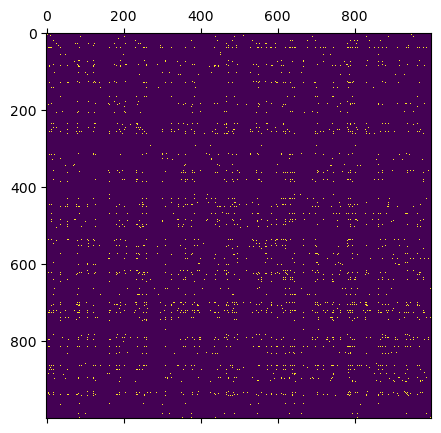

In [292]:
fig, axarr = plt.subplots(figsize = (5,5))                   
axarr.matshow(adj_mat, alpha = 1)
plt.show()